# <a id='toc1_'></a>[Task 1. Web scraping and analysis](#toc0_)

---

The objective of this project is to gather customer feedback and review data about British Airways from the Air Travel review website [Skytrax](https://www.airlinequality.com/). We will perform data cleaning, exploration, visualization, and statistical analysis to extract valuable insights and present them in an engaging and informative manner.

**Table of contents**<a id='toc0_'></a>    
- [Task 1. Web scraping and analysis](#toc1_)    
  - [Workplan](#toc1_1_)    
  - [Libraries, modules, constants and custom functions](#toc1_2_)    
  - [1. Data Gathering](#toc1_3_)    
  - [2. Data Cleaning and Exploration](#toc1_4_)    
    - [2.1 Title](#toc1_4_1_)    
    - [2.2 Author](#toc1_4_2_)    
    - [2.3 Country](#toc1_4_3_)    
    - [2.4 Rating](#toc1_4_4_)    
    - [2.5 Date of publishing and Date of flight](#toc1_4_5_)    
    - [2.6 Type of traveller](#toc1_4_6_)    
    - [2.7 Seat type](#toc1_4_7_)    
    - [2.8 Route and Aircraft](#toc1_4_8_)    
    - [2.9 Additional ratings](#toc1_4_9_)    
    - [2.10 Recommended](#toc1_4_10_)    
    - [2.11 Review text](#toc1_4_11_)    
    - [2.12 Summary of Data Cleaning and Exploration](#toc1_4_12_)    
  - [3. Data Analysis](#toc1_5_)    
    - [3.1 Topic Modeling](#toc1_5_1_)    
    - [3.2 Correlation Analysis](#toc1_5_2_)    
  - [4. Conclusion](#toc1_6_)    
  - [Appendix](#toc1_7_)    

<!-- vscode-jupyter-toc-config
	numbering=false
	anchor=true
	flat=false
	minLevel=1
	maxLevel=6
	/vscode-jupyter-toc-config -->
<!-- THIS CELL WILL BE REPLACED ON TOC UPDATE. DO NOT WRITE YOUR TEXT IN THIS CELL -->

## <a id='toc1_1_'></a>[Workplan](#toc0_)

__1. Data Gathering__

- Extract all available reviews specifically about British Airlines from the provided [website](https://www.airlinequality.com/airline-reviews/british-airways).

__2. Data Cleaning and Exploration__

- Clean the extracted data to remove inconsistencies, duplicates, and irrelevant information.
- Explore the data to identify patterns, trends, and key metrics related to customer feedback and reviews.

__3. Data Analysis__

- Conduct analysis on the collected data to gain deeper insights into customer sentiments, ratings, and preferences.
- Generate visualizations to effectively communicate the analysis results.

__4. Conclusion__

- Summarize the findings and insights obtained from the data analysis.
- Create a concise and visually appealing PowerPoint slide that includes key visualizations, metrics, and clear explanations to highlight the main points derived from the analysis.

## <a id='toc1_2_'></a>[Libraries, modules, constants and custom functions](#toc0_)

In [1]:
# used libraries and modules
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from phik.report import plot_correlation_matrix

import re
import spacy
import pyLDAvis.gensim_models

pyLDAvis.enable_notebook()
import en_core_web_md
from gensim.corpora.dictionary import Dictionary
from gensim.models import LdaMulticore
from gensim.models import CoherenceModel
from wordcloud import WordCloud

from selenium import webdriver
from selenium.webdriver.firefox.service import Service
from selenium.webdriver.firefox.options import Options
from selenium.webdriver.common.by import By
from selenium.webdriver.support.ui import WebDriverWait
from selenium.webdriver.support import expected_conditions as EC

from pycountry_convert import (
    country_alpha2_to_continent_code,
    country_name_to_country_alpha2,
)

from tqdm import tqdm
import time

In [2]:
# directories and other variables
URL = "https://www.airlinequality.com/airline-reviews/british-airways/page/1/?sortby=post_date%3ADesc&pagesize=100"
DRIVER_PATH = "geckodriver"  # location of browser driver
SLEEP_TIME = 10
STATE = 1000

# dataframe options
pd.set_option("display.max_columns", None)

In [3]:
# functions used for data gathering


# function for extraction country of origin from reviews
def extract_country(text):
    if "(" in text and ")" in text:
        return text[text.index("(") + 1 : text.index(")")]
    else:
        return "unknown"

In [4]:
# functiions used for data preprocessing


# function for data info
def show_info(df):
    display(df.info())
    print("-------------------------------")
    display(df.describe(include="all"))
    display(df.head())


# function for column examination
def show_uniques(col):
    num = df[col].nunique()
    # print(f"Number of unique values - {num}")
    # print(df[col].value_counts(dropna=False))
    if num < 10:
        draw_pie(col, df)
    else:
        counts = df[col].replace(np.nan, "missing").value_counts()
        above_threshold = counts[6:]
        counts = counts[:6]
        counts.loc["others"] = above_threshold.sum()
        counts = counts.to_frame()
        draw_pie("count", counts)


# function to get the continent for a given country
def get_continent(country):
    if country == "United Kingdom":
        return "United Kingdom"
    else:
        try:
            country_code = country_name_to_country_alpha2(country)
            continent_code = country_alpha2_to_continent_code(country_code)
            if continent_code:
                return continent_code
        except KeyError:
            pass
    return None

In [5]:
# functions used for visualizations


# function for drawing pie charts
def draw_pie(col, df):
    if len(df.columns) == 1:
        fig = go.Figure(
            data=[
                go.Pie(
                    values=df[col].replace(np.nan, "missing"),
                    labels=df[col].replace(np.nan, "missing").index,
                    title=f"Distribution of {col.upper()}",
                )
            ]
        )
        fig.update_traces(
            hoverinfo="label+value", textinfo="label+percent", textposition="inside"
        )
        fig.show()
    else:
        fig = go.Figure(
            data=[
                go.Pie(
                    values=df[col].replace(np.nan, "missing").value_counts(),
                    labels=df[col].replace(np.nan, "missing").value_counts().index,
                    title=f"Distribution of {col.upper()}",
                )
            ]
        )
        fig.update_traces(
            hoverinfo="label+value", textinfo="label+percent", textposition="inside"
        )
        fig.show()


#
def draw_graphs(col):
    fig = make_subplots(
        rows=2,
        cols=3,
        specs=[
            [{"type": "domain"} for _ in range(3)],
            [{"type": "box"}, {"colspan": 2}, None],
        ],
    )
    for i, data in enumerate(dfs.keys()):
        fig.add_trace(
            go.Pie(
                values=dfs[data][col].value_counts(),
                labels=dfs[data][col].value_counts().index,
                title=f"Pie {data}",
            ),
            row=1,
            col=i + 1,
        )
    fig.update_traces(
        hoverinfo="label+value", textinfo="label+percent", textposition="inside"
    )
    for data in dfs.keys():
        fig.add_trace(
            go.Box(y=dfs[data][col], name=f"Box {data}"),
            row=2,
            col=1,
        )
        fig.add_trace(
            go.Histogram(x=dfs[data][col], name=f"Hist {data}"),
            row=2,
            col=2,
        )
    fig.update_layout(height=800, title_text=f"{col} distribution")
    fig.show()

In [6]:
# functions for text process and analysis


def remove_trip_verification(text):
    if "|" in text:
        text = text[text.index("|") + 1 :]
    return text

## <a id='toc1_3_'></a>[1. Data Gathering](#toc0_)

[The Air Travel review website](www.airlinequality.com) is a renowned customer forum that specializes in providing comprehensive reviews for airlines, airports, and related air travel experiences. As part of this project, we will focus on extracting data specifically related to British Airways from this website. The targeted data can be accessed through the following link: [Skytrax - British Airways Reviews](https://www.airlinequality.com/airline-reviews/british-airways).

The data available on the website is spread across multiple pages and encompasses a wide range of information related to flight details, customer experiences, and the quality of various services offered by British Airways. It is important to note that the reviews may vary in terms of content and structure, requiring us to exercise caution to ensure that valuable data is not overlooked.

In [ ]:
# temporary list for storing reviews
reviews = []

# open firefox browser in new window
firefox_options = Options()
firefox_options.add_argument("--headless=new")
# stop waiting for full webpage load
firefox_options.page_load_strategy = "eager"
driver_service = Service(DRIVER_PATH)
driver = webdriver.Firefox(service=driver_service, options=firefox_options)

# open URL and locate data
driver.get(URL)
wait = WebDriverWait(driver, SLEEP_TIME)
table_locator = (
    By.CSS_SELECTOR,
    "section.layout-section:nth-child(3) > div:nth-child(1)",
)
time.sleep(SLEEP_TIME)
table = driver.find_element(*table_locator)

# define total pages
last_page = int(
    driver.find_element(
        By.CSS_SELECTOR,
        ".comp_reviews-pagination > ul:nth-child(1) > li:nth-child(8)",
    ).text
)

# iterate over pages
for page in tqdm(range(1, last_page + 1)):
    # open URL
    driver.get(
        f"https://www.airlinequality.com/airline-reviews/british-airways/page/{page}/?sortby=post_date%3ADesc&pagesize=100"
    )
    wait.until(EC.staleness_of(table))
    table = driver.find_element(*table_locator)
    rows = driver.find_elements("css selector", "article[itemprop='review']")
    for row in rows:
        title = row.find_element("css selector", "h2[class='text_header']").text
        author = row.find_element("css selector", "span[itemprop='name']").text
        country = extract_country(row.find_element("css selector", "h3").text)
        try:
            rating = row.find_element(
                "css selector", "span[itemprop='ratingValue']"
            ).text
            rating_scale = row.find_element(
                "css selector", "span[itemprop='bestRating']"
            ).text
        except:
            rating = "unknown"
            rating_scale = "unknown"
        date = row.find_element(
            "css selector", "meta[itemprop='datePublished']"
        ).get_attribute("content")
        review_text = row.find_element(
            "css selector", "div[itemprop='reviewBody']"
        ).text
        review = {
            "title": title,
            "author": author,
            "country": country,
            "rating": rating,
            "rating_scale": rating_scale,
            "review_date": date,
            "review_text": review_text,
        }
        review_stats = row.find_elements(By.TAG_NAME, "tr")
        for stat in review_stats:
            if stat.find_elements(By.TAG_NAME, "td")[-1].text == "12345":
                review[
                    stat.find_elements(By.TAG_NAME, "td")[0]
                    .text.replace(" ", "_")
                    .lower()
                ] = stat.find_elements("css selector", "span[class='star fill']")[
                    -1
                ].text
            else:
                review[
                    stat.find_elements(By.TAG_NAME, "td")[0]
                    .text.replace(" ", "_")
                    .lower()
                ] = stat.find_elements(By.TAG_NAME, "td")[-1].text

        reviews.append(review)
print(f"Amount of parsed reviews is {len(reviews)}.")

In [ ]:
# create and save dataframe with extracted data
df = pd.DataFrame(reviews)
df.to_csv("BA_reviews.csv")

## <a id='toc1_4_'></a>[2. Data Cleaning and Exploration](#toc0_)
After obtaining the data from the website, the next crucial step is to preprocess and clean it for analysis. Since the reviews are likely to be unstructured and messy, it is important to perform data cleaning procedures to make the data more manageable and suitable for analysis.

During the data cleaning process, the following steps will be undertaken:
- Remove any unnecessary text or characters from dataset to extract relevant information.
- Address any missing or empty values in the dataset, ensuring that they are appropriately handled or filled in.
- Check for and handle potential duplicates in the dataset to avoid any redundant information.

Simultaneously, we will begin the Exploratory Data Analysis phase to gain a comprehensive understanding of the dataset. This involves examining the distribution and summary statistics of different categories within the dataset, providing insights into the data's structure and characteristics.

By performing these data cleaning and EDA operations, we can ensure that the dataset is properly formatted, devoid of inconsistencies or errors, and ready for further in-depth analysis.

In [8]:
# show initial dataset info
show_info(df)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3554 entries, 0 to 3553
Data columns (total 21 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Unnamed: 0              3554 non-null   int64  
 1   title                   3554 non-null   object 
 2   author                  3554 non-null   object 
 3   country                 3554 non-null   object 
 4   rating                  3554 non-null   object 
 5   rating_scale            3554 non-null   object 
 6   review_date             3554 non-null   object 
 7   review_text             3554 non-null   object 
 8   aircraft                1850 non-null   object 
 9   type_of_traveller       2784 non-null   object 
 10  seat_type               3552 non-null   object 
 11  route                   2779 non-null   object 
 12  date_flown              2776 non-null   object 
 13  seat_comfort            3450 non-null   float64
 14  cabin_staff_service     3440 non-null   

None

-------------------------------


,Unnamed: 0,title,author,country,rating,rating_scale,review_date,review_text,aircraft,type_of_traveller,seat_type,route,date_flown,seat_comfort,cabin_staff_service,inflight_entertainment,ground_service,wifi_&_connectivity,value_for_money,recommended,food_&_beverages
count,3554.000000,3554,3554,3554,3554,3554,3554,3554,1850,2784,3552,2779,2776,3450.000000,3440.000000,2477.000000,2714.000000,556.000000,3553.000000,3554,3203.000000
unique,NaN,2540,2771,71,11,2,1721,3535,191,4,4,1478,106,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN
top,NaN,British Airways customer review,David Ellis,United Kingdom,1,10,2015-01-19,"We flew ""Business/1st class"" from London to Du...",A320,Couple Leisure,Economy Class,London to Johannesburg,August 2015,NaN,NaN,NaN,NaN,NaN,NaN,no,NaN
freq,NaN,956,43,2259,788,3549,26,2,342,942,1840,18,83,NaN,NaN,NaN,NaN,NaN,NaN,2085,NaN
mean,1776.500000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.894783,3.269477,2.651998,2.825718,1.931655,2.721081,NaN,2.727131
std,1026.095756,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.362081,1.486705,1.398999,1.449299,1.359254,1.469337,NaN,1.440200
min,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,NaN,1.000000
25%,888.250000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.000000,2.000000,1.000000,1.000000,1.000000,1.000000,NaN,1.000000
50%,1776.500000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.000000,3.000000,3.000000,3.000000,1.000000,3.000000,NaN,3.000000
75%,2664.750000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.000000,5.000000,4.000000,4.000000,3.000000,4.000000,NaN,4.000000


,Unnamed: 0,title,author,country,rating,rating_scale,review_date,review_text,aircraft,type_of_traveller,seat_type,route,date_flown,seat_comfort,cabin_staff_service,inflight_entertainment,ground_service,wifi_&_connectivity,value_for_money,recommended,food_&_beverages
0,0,"""Last time I will fly British Airways""",S Anderson,Canada,2,10,2023-05-27,✅ Trip Verified | Worst seats I have ever enco...,A320,Couple Leisure,Economy Class,Lisbon to London,May 2023,1.0,3.0,1.0,1.0,1.0,2.0,no,NaN
1,1,"""cancel your flight without notice""",B Sherry,United States,1,10,2023-05-23,Not Verified | Top Ten REASONS to not use Brit...,NaN,Couple Leisure,Premium Economy,Dallas to Madrid via London,May 2023,1.0,1.0,1.0,1.0,1.0,1.0,no,1.0
2,2,"""flights changed with no cost""",William Jackson,Spain,10,10,2023-05-23,Not Verified | Easy check in on the way to Hea...,NaN,Couple Leisure,Economy Class,London to Valencia,March 2023,4.0,4.0,NaN,5.0,NaN,4.0,yes,NaN
3,3,"""Cheap, quick and efficient""",A Warten,Chile,10,10,2023-05-23,✅ Trip Verified | Online check in worked fine....,A320,Solo Leisure,Economy Class,London to Glasgow,May 2023,5.0,5.0,NaN,5.0,NaN,5.0,yes,5.0
4,4,"""the worst major European airline""",E Michaels,United Kingdom,2,10,2023-05-22,✅ Trip Verified |. The BA first lounge at Term...,A320 Finnair,Business,Business Class,London Heathrow to Malaga,May 2023,2.0,2.0,1.0,1.0,1.0,1.0,no,3.0


The initial dataset comprises a total of 3553 reviews. It consists of several columns, each providing specific information about the reviews:

- `title`: The title of the review.
- `author`: The name of the author.
- `country`: The country of the author.
- `rating`: The overall rating given by the author.
- `rating_scale`: The scale of the rating. If all the ratings have the same scale, this column may be removed.
- `review_date`: The date when the review was published.
- `review_text`: The actual text of the review.
- `type_of_traveller`: The type of traveler, has 4 unique types.
- `seat_type`: The class or type of seat, has 4 unique types.
- `route`: The flight route.
- `date_flown`: The date of the flight.
- `recommended`: The overall conclusion or recommendation regarding the airline.
- `aircraft`: The model of the aircraft.
- Additional ratings: There are several additional ratings provided for individual services such as seat comfort, cabin staff service, food and beverages, inflight entertainment, ground service, Wi-Fi and connectivity, and value for money. These ratings are on a scale of 1 to 5.

Upon closer examination of the dataset, certain columns may be rearranged or even removed. 

The initial check revealed several empty values that require further investigation. 

Of particular interest is the `review_text` column, which needs to be prepared for semantic analysis. However, before proceeding, we will examine each column in the dataset individually.

In [9]:
# remove duplicates
df.drop_duplicates(inplace=True)
df.duplicated().sum()

0

### <a id='toc1_4_1_'></a>[2.1 Title](#toc0_)

In [10]:
show_uniques("title")

It is likely that the `title` column serves as a brief summary of the corresponding `review_text`. However, there are 944 reviews with a default title. Considering our main focus on the `review_text` column, we will keep the title column unchanged and out of analysis, just to provide a rough idea about the text of each review. During the data preprocessing stage, we will arrange these two columns to be in close proximity, as they convey similar information.

### <a id='toc1_4_2_'></a>[2.2 Author](#toc0_)

In [11]:
show_uniques("author")

Considering that a few customers may leave more reviews than others, their contribution to the overall dataset is not significant. Hence, we will exclude this column from our analysis to avoid undue emphasis on a small subset of customers.

### <a id='toc1_4_3_'></a>[2.3 Country](#toc0_)

In [12]:
# create a new 'continent' column
df["continent"] = df["country"].map(get_continent)
show_uniques("country")
show_uniques("continent")

To gain further insights into the countries of origin of customers, we introduced an additional column called `continent`. However, we treated the United Kingdom separately as it serves as the home country of the airline and attracts a significant number of customers from that region.

Upon analysis, we observed that nearly two-thirds of all customers are citizens of the United Kingdom, while approximately 14% of customers are from North America, mainly from the USA and Canada. 10.5% of customers originate from various European countries, without any particular country standing out prominently. Australian customers comprise 4.3% of the total, which is slightly lower than the percentage of customers from all Asian countries combined.  However, we have a limited number of reviews from South American and African customers.

### <a id='toc1_4_4_'></a>[2.4 Rating](#toc0_)

In [13]:
show_uniques("rating_scale")
show_uniques("rating")

In [14]:
df[df["rating"] == "unknown"]

,Unnamed: 0,title,author,country,rating,rating_scale,review_date,review_text,aircraft,type_of_traveller,seat_type,route,date_flown,seat_comfort,cabin_staff_service,inflight_entertainment,ground_service,wifi_&_connectivity,value_for_money,recommended,food_&_beverages,continent
2981,2981,British Airways customer review,Ray Desjardins,United Kingdom,unknown,unknown,2015-02-18,Cabin crew polite unfortunately BA ran out of ...,NaN,NaN,Economy Class,NaN,NaN,3.0,5.0,1.0,NaN,NaN,2.0,no,1.0,United Kingdom
3107,3107,British Airways customer review,Neil Balter,United States,unknown,unknown,2014-12-10,Phoenix to London - outbound a wonderful and e...,NaN,NaN,First Class,NaN,NaN,1.0,5.0,2.0,NaN,NaN,2.0,no,4.0,NA
3126,3126,British Airways customer review,D Thomas,United Kingdom,unknown,unknown,2014-11-25,On past experience I chose BA for our long hau...,NaN,NaN,Economy Class,NaN,NaN,3.0,3.0,1.0,NaN,NaN,3.0,no,2.0,United Kingdom
3360,3360,British Airways customer review,J Whittle,United Kingdom,unknown,unknown,2014-07-31,LHR-CPH-LHR Business Class. This is a joke. Sc...,NaN,NaN,Business Class,NaN,NaN,1.0,1.0,1.0,NaN,NaN,1.0,no,1.0,United Kingdom
3392,3392,British Airways customer review,Jackie Craig,Italy,unknown,unknown,2014-07-15,I flew with British Airways with my mother fro...,NaN,NaN,Economy Class,NaN,NaN,1.0,3.0,1.0,NaN,NaN,1.0,no,1.0,EU


The most common rating received by British Airways from its customers is `1`, accounting for 22.2% of the total reviews. Ratings from `2` to `10` are distributed relatively evenly across the remaining reviews.

It is worth noting that there are 5 reviews that do not have an overall rating assigned. By considering the ratings for additional services and the overall negative recommendation for the airline, we can make an assumption about the missing overall ratings in order to maintain data completeness. However, it should be mentioned that these reviews are dated back to 2014 and early 2015, and they may not be included in the final analysis due to their age and loss of relevance. Additionally, the type of data in the `rating` column should be converted to numeric values for proper analysis.

Regarding the `rating_scale` column, it is evident that all reviews have a single rating scale. Therefore, this column can be safely removed from the dataset as it does not provide any additional information.

In [15]:
# assign assumed rating to missing values
df.loc[df[df["rating"] == "unknown"].index, "rating"] = round(
    df["value_for_money"].fillna(-1).astype(int) * 1.4
)
df["rating"] = df["rating"].astype(int)

### <a id='toc1_4_5_'></a>[2.5 Date of publishing and Date of flight](#toc0_)

In [16]:
show_uniques("review_date")
show_uniques("date_flown")

Within the dataset, there are two date-related columns: one indicating the date when the review was posted, and the other representing the date of the actual flight. While the review date includes information about the day, month, and year, the flight date is limited to just the month and year, and in some cases, it may even be empty. Due to this limitation, we are unable to analyze the day of the week for the flights. 

However, we can still attempt to fill in the missing values for the `date_flown` column if there is not a significant time difference between the known review and flight dates. To accomplish this, first we need to convert both columns into the appropriate date format.

As mentioned earlier, it is important to acknowledge that some reviews in the dataset may be significantly outdated. Over time, circumstances and conditions change, rendering older reviews potentially irrelevant in the present context. To address this, we can establish a date threshold that determines the relevancy of reviews. By dividing the dataset based on this threshold, we can compare the reviews before and after the cutoff.

Determining the appropriate date threshold for relevance of reviews depends on various factors, including the frequency of changes and updates in the operations and services of the airline. A reasonable approach could be to consider a threshold of the past three years. This means reviews older than three years may be considered less relevant due to potential changes in the airline's offerings, policies, and overall customer experience. However, it's important to note that this is just a suggestion, and it would be beneficial to consult with domain experts or refer to official sources to determine a more precise threshold based on the specific context of British Airways.

In [17]:
# convert date formats
df["review_date"] = pd.to_datetime(df["review_date"])
df["flight_date"] = pd.to_datetime(df["date_flown"])

# find time difference between post and flight dates
df["time_diff"] = (df["review_date"] - df["flight_date"]).dt.days
display(df[df["time_diff"].isna()].sort_values("review_date", ascending=False).head())
fig_time_diff = px.histogram(
    df,
    x="time_diff",
    nbins=50,
    marginal="box",
    title="Distribution of time difference between review post and flight dates",
)
fig_time_diff.show()
print(
    "Average time difference between review post and flight dates is",
    df["time_diff"].mean(),
)
print(
    "Median time difference between review post and flight dates is",
    df["time_diff"].median(),
)

/var/folders/r6/9jdwsy656835n306zgn8lj8r0000gn/T/ipykernel_75805/1319576206.py:3: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



,Unnamed: 0,title,author,country,rating,rating_scale,review_date,review_text,aircraft,type_of_traveller,seat_type,route,date_flown,seat_comfort,cabin_staff_service,inflight_entertainment,ground_service,wifi_&_connectivity,value_for_money,recommended,food_&_beverages,continent,flight_date,time_diff
2699,2699,British Airways customer review,M Hawthorn,United Kingdom,3,10,2015-07-22,"Day trip to Vienna, used BA Economy as their B...",A320,Business,Economy Class,LHR to VIE return,NaN,3.0,2.0,NaN,2.0,NaN,3.0,no,2.0,United Kingdom,NaT,NaN
2779,2779,British Airways customer review,Sasha Guignard,Ukraine,8,10,2015-06-12,Flew from Kiev to London on their Airbus 319 i...,Airbus 319,Business,Business Class,Kiev to London,NaN,3.0,5.0,4.0,NaN,1.0,4.0,yes,NaN,EU,NaT,NaN
2777,2777,British Airways customer review,Colin Pay,United Kingdom,4,10,2015-06-12,"FRA-LHR on A319, We sat on the plane at the ga...",A319,Business,Business Class,FRA-LHR,NaN,5.0,2.0,1.0,NaN,NaN,1.0,no,2.0,United Kingdom,NaT,NaN
2778,2778,British Airways customer review,Mike Dickinson,Sweden,5,10,2015-06-12,Flew Club World from Gatwick to Barbados in Ap...,Boeing 777,Couple Leisure,Business Class,Gatwick to Barbados,NaN,3.0,4.0,4.0,NaN,NaN,3.0,no,3.0,EU,NaT,NaN
2783,2783,British Airways customer review,Kevin Barrance,United Kingdom,3,10,2015-06-11,This review refers to a return trip from India...,NaN,Business,Premium Economy,BOM-LHR,NaN,4.0,1.0,3.0,NaN,NaN,3.0,no,1.0,United Kingdom,NaT,NaN


Average time difference between review post and flight dates is 35.913184438040346
Median time difference between review post and flight dates is 24.0


In [18]:
# check the review which assumingly was posted before the flight
with pd.option_context("display.max_colwidth", None):
    display(df[df["time_diff"] < 0])

,Unnamed: 0,title,author,country,rating,rating_scale,review_date,review_text,aircraft,type_of_traveller,seat_type,route,date_flown,seat_comfort,cabin_staff_service,inflight_entertainment,ground_service,wifi_&_connectivity,value_for_money,recommended,food_&_beverages,continent,flight_date,time_diff
264,264,"""caused our family extreme stress and disappointment""",D Meares,United Kingdom,2,10,2022-04-06,✅ Trip Verified | British Airways is the most terrible airline I’ve ever dealt with. They have caused our family extreme stress and disappointment - we have tried for a week now to speak to someone as we can’t make the changes online. They hang up on you every time you call them - we have been driven to despair by their treatment of their customers. I have no choice but to cancel our chance of a life time trip we’d booked with our 2 18 year old boys as they were flying with another airline and would have been alone in Japan as BA just cancelled our trip and we cannot rebook online as the trip was booked with avios and companion vouchers.,NaN,Family Leisure,Business Class,London to Tokyo,June 2022,NaN,NaN,NaN,NaN,NaN,1.0,no,NaN,United Kingdom,2022-06-01,-56.0


Upon further investigation, we discovered that the reviews with missing flight dates were all from 2015 and earlier, suggesting their potential irrelevance to the current analysis. However, we can still fill in the missing values based on the observation that reviews were typically posted within 35 days (median of 24 days) after the flight for reviews with known dates. Considering that, it is reasonable to assume that the month and year of the flight align with the review date.

During this process, we encountered a review that appeared to have been made two months before the actual flight. Further examination revealed that the flight booking was eventually canceled, and the flight date was likely entered erroneously.

To determine the appropriate threshold, we need to consider the number of flights made in each year to avoid removing a significant amount of data. Additionally, pinpointing the month of the flight could prove useful in the analysis. As the flight date is more critical than the review date for our analysis, we have decided to remove the review date column, retaining only the flight date.

Furthermore, we have renamed the column names to ensure better consistency and coherence throughout the dataset.

In [19]:
# filling missing values for flight date
df.loc[df[df["flight_date"].isna()].index, "flight_date"] = (
    df["review_date"].dt.to_period("M").astype("datetime64[M]")
)

# extract month and year from flight date
df["flight_month"] = df["flight_date"].dt.month
df["flight_year"] = df["flight_date"].dt.year

# choosing threshold year
for threshold in range(2, 10):
    num = len(df[df["flight_year"] >= 2023 - threshold])
    print(
        f"For {threshold} years threshold, dataset is {num/len(df):.2%} ({num} reviews starting from {2023-threshold} year)"
    )
fig_flight_year = px.histogram(
    df,
    x="flight_year",
    marginal="box",
    title="Distribution of flights between years",
)
fig_flight_year.show()

For 2 years threshold, dataset is 11.31% (402 reviews starting from 2021 year)
For 3 years threshold, dataset is 13.96% (496 reviews starting from 2020 year)
For 4 years threshold, dataset is 23.41% (832 reviews starting from 2019 year)
For 5 years threshold, dataset is 32.92% (1170 reviews starting from 2018 year)
For 6 years threshold, dataset is 48.68% (1730 reviews starting from 2017 year)
For 7 years threshold, dataset is 64.52% (2293 reviews starting from 2016 year)
For 8 years threshold, dataset is 86.16% (3062 reviews starting from 2015 year)
For 9 years threshold, dataset is 99.58% (3539 reviews starting from 2014 year)


Choosing the appropriate threshold for our analysis requires striking a balance. Setting a very low threshold would result in a significant loss of data, while setting a very high threshold might introduce outdated conditions that could affect our analysis. After careful consideration, we have determined that an optimal threshold would be around 6 to 7 years. This range would allow us to retain a substantial portion of the data, with approximately 50% to 65% available for analysis.

### <a id='toc1_4_6_'></a>[2.6 Type of traveller](#toc0_)

In [20]:
show_uniques("type_of_traveller")

This distribution indicates that the majority of travelers were either solo leisure travelers or couples on leisure trips, with a significant portion also consisting of business travelers. The proportion of families on leisure trips is relatively lower compared to the other categories.

### <a id='toc1_4_7_'></a>[2.7 Seat type](#toc0_)

In [21]:
show_uniques("seat_type")

The distribution of seat types provides insights into the preferences and priorities of customers when it comes to their travel arrangements, taking into account factors such as cost, comfort, convenience, and the level of luxury they desire. 

The majority of customers, accounting for 51.7%, chose to travel in economy class. This indicates that affordability and cost-consciousness are important factors for a significant portion of customers.

On the other hand, 32.5% of customers opted for the business class seats. This suggests that a notable portion of customers prioritize comfort, convenience, and enhanced services during their travel experience. Business travelers, in particular, may value the additional amenities and services offered in the business class cabin.

Furthermore, 9.83% of customers selected the premium economy class seats. This indicates that there is a segment of customers who are willing to pay a bit more for extra comfort and amenities, but may not require the full luxury experience of first class.

Lastly, the first-class seats were chosen by 5.96% of customers. First class is typically associated with the highest level of luxury, personalized service, and exclusivity. This suggests that a smaller but discerning group of customers seek the utmost luxury and premium travel experience.

### <a id='toc1_4_8_'></a>[2.8 Route and Aircraft](#toc0_)

In [22]:
show_uniques("route")
show_uniques("aircraft")

The `route` column in the dataset exhibits a significant variance in the routes taken by customers. This indicates that British Airways serves a diverse range of destinations and offers numerous flight routes to cater to the needs of different travelers. However, despite the rich information contained in the route column, it is advisable to omit this column from the analysis. Extracting separate destination and departure cities from the route column may not contribute significantly to the overall analysis and insights as well.

The `aircraft` column in the dataset reveals a wide variety of aircraft models used by British Airways. It is recommended to exclude the aircraft column from the analysis for similar reasons as the `route` column. While the information about the specific aircraft models can be intriguing, it may not contribute significantly to the primary focus of the analysis. The aircraft models used by an airline may have certain implications on aspects such as comfort, amenities, and overall travel experience. However, extracting meaningful insights solely from the aircraft column might prove challenging without comprehensive data on specific features, configurations, or performance metrics of each aircraft model.

To ensure a focused and impactful analysis, it is advisable to prioritize other key variables that directly influence customer experiences. 

### <a id='toc1_4_9_'></a>[2.9 Additional ratings](#toc0_)

In [23]:
services = [
    "seat_comfort",
    "cabin_staff_service",
    "food_&_beverages",
    "inflight_entertainment",
    "ground_service",
    "wifi_&_connectivity",
    "value_for_money",
]
for service in services:
    df[service] = df[service].fillna(-1).replace("N/A", -1).astype(int)
    show_uniques(service)

In the ratings of different services, we encountered a significant number of missing values. To address this, we filled those missing values with negative values, enabling us to convert the ratings to numeric values. This step was necessary to ensure that the ratings can be accurately analyzed in subsequent stages.

### <a id='toc1_4_10_'></a>[2.10 Recommended](#toc0_)

In [24]:
show_uniques("recommended")

This distribution indicates a significant portion of customers expressing dissatisfaction or negative experiences with the airline. As there are no missing values or obvious mistakes, there is no need for further data preparation for this column, and it can be directly utilized for further analysis.

### <a id='toc1_4_11_'></a>[2.11 Review text](#toc0_)
Now that we have reached the text preprocessing phase, we will proceed with the following steps:
- Conduct essential data cleaning procedures, including the removal of irrelevant characters, punctuation marks, and special symbols.
- Convert the text to lowercase to ensure uniformity and consistency.
- Eliminate stopwords, which are commonly used words with limited semantic value, from the text.
- Implement stemming or lemmatization techniques to normalize the words and reduce them to their base or root forms, enhancing further analysis.
- Visualize the word cloud of most common words to verify the preprocessing.

/Users/asyl/Desktop/DS/venv2/lib/python3.10/site-packages/wordcloud/wordcloud.py:106: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



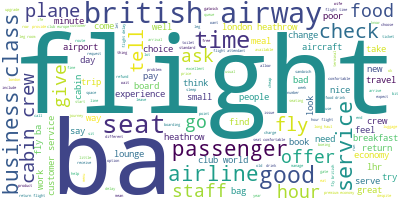

In [25]:
# review text processing
nlp = en_core_web_md.load()
# removing words and symbols with limited semantic value
removal = ["ADV", "PRON", "CCONJ", "PUNCT", "PART", "DET", "ADP", "SPACE", "NUM", "SYM"]
tokens = []
df["review_text"] = df["review_text"].apply(remove_trip_verification)
for text in nlp.pipe(df["review_text"]):
    proj_tok = [
        token.lemma_.lower()
        for token in text
        if token.pos_ not in removal and not token.is_stop and token.is_alpha
    ]
    tokens.append(proj_tok)
df["tokens"] = tokens

# visualize the word cloud
long_string = ",".join([" ".join(row) for row in df["tokens"].values])
wordcloud = WordCloud(background_color="white", max_words=1000, contour_width=3)
wordcloud.generate(long_string)
wordcloud.to_image()

We observed that some of the most common words in the reviews are related to the airline itself, such as "BA," "British Airways," "airline," and "flight". Since these words are expected to appear frequently in the context of reviews about British Airways, they may not provide much meaningful information for our analysis. Therefore, it would be appropriate to remove these common airline-related terms from the text data.

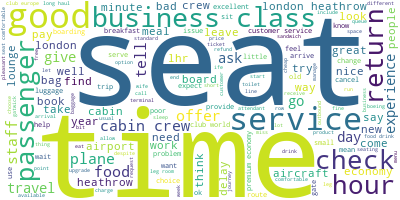

In [26]:
# removing additional words
additional_removal = ["ba", "airway", "airline", "flight", "fly", "british", "airways"]
df = df.drop("tokens", axis=1)
tokens = []
for text in nlp.pipe(df["review_text"]):
    proj_tok = [
        token.lemma_.lower()
        for token in text
        if token.pos_ not in removal
        and not token.is_stop
        and token.is_alpha
        and token.lemma_.lower() not in additional_removal
    ]
    tokens.append(proj_tok)
df["tokens"] = tokens

# visualize the word cloud
long_string = ",".join([" ".join(row) for row in df["tokens"].values])
wordcloud.generate(long_string)
wordcloud.to_image()

### <a id='toc1_4_12_'></a>[2.12 Summary of Data Cleaning and Exploration](#toc0_)
The data is now prepared for further analysis after completing the data cleaning and exploration steps. Here is a summary of the actions taken during this process:

1. Duplicate Removal: All duplicate rows were removed from the dataset to ensure data integrity.
2. Column Exploration: Each column was examined to understand its contents and identify any potential issues or patterns, which later will be used in data analysis.
3. Continent Column Creation: A new column called `continent` was created based on the country of origin of the authors of the reviews, providing additional information for analysis.
4. Data Conversion: The data was converted to the appropriate formats, such as converting numeric data to numerical types and converting date-related columns to date formats.
5. Missing Flight Dates: Flight dates were calculated for reviews that were missing this information, utilizing other available data.
6. Threshold Year: A threshold year was established to determine the relevance of reviews, considering their publication date and the evolving nature of the airline industry.
7. Additional Date Columns: Two new columns, `month` and `year` were created to capture the month and year of the flight date, providing more granular insights.
8. Text Preparation: The review text was prepared for text analysis by performing necessary cleaning steps, such as removing irrelevant characters, converting the text to lowercase, eliminating stopwords and implementing lemmatization.

The remaining steps include filling any remaining missing values and removing obsolete columns from the dataset, setting the stage for further analysis and insights. 

In the final step, we will partition the available data into subsets based on the threshold year value we established earlier. This division will allow us to distinguish between reviews that are considered relevant and those that might be outdated for analysis purposes. By separating the data in this manner, we can focus our analysis on the most recent and pertinent reviews, ensuring that our insights are based on current trends and experiences.

In [27]:
# fill missing values
df = df.fillna("unknown").reset_index()

# drop and rearrange columns
cols_to_stay = [
    "flight_date",
    "flight_year",
    "flight_month",
    "continent",
    "country",
    "seat_type",
    "type_of_traveller",
    "seat_comfort",
    "cabin_staff_service",
    "food_&_beverages",
    "inflight_entertainment",
    "ground_service",
    "wifi_&_connectivity",
    "value_for_money",
    "recommended",
    "rating",
    "title",
    "review_text",
    "tokens",
]
df_origin = df.copy()
df = df[cols_to_stay]

# separate the irrelevant data
threshold = 7
df_all = df.copy()
df_olds = df[df["flight_year"] < 2023 - threshold]
df = df[df["flight_year"] >= 2023 - threshold]

# check
show_info(df)

<class 'pandas.core.frame.DataFrame'>
Index: 2293 entries, 0 to 2326
Data columns (total 19 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   flight_date             2293 non-null   datetime64[ns]
 1   flight_year             2293 non-null   int32         
 2   flight_month            2293 non-null   int32         
 3   continent               2293 non-null   object        
 4   country                 2293 non-null   object        
 5   seat_type               2293 non-null   object        
 6   type_of_traveller       2293 non-null   object        
 7   seat_comfort            2293 non-null   int64         
 8   cabin_staff_service     2293 non-null   int64         
 9   food_&_beverages        2293 non-null   int64         
 10  inflight_entertainment  2293 non-null   int64         
 11  ground_service          2293 non-null   int64         
 12  wifi_&_connectivity     2293 non-null   int64        

None

-------------------------------


,flight_date,flight_year,flight_month,continent,country,seat_type,type_of_traveller,seat_comfort,cabin_staff_service,food_&_beverages,inflight_entertainment,ground_service,wifi_&_connectivity,value_for_money,recommended,rating,title,review_text,tokens
count,2293,2293.000000,2293.000000,2293,2293,2293,2293,2293.000000,2293.000000,2293.000000,2293.000000,2293.000000,2293.000000,2293.000000,2293,2293.000000,2293,2293,2293
unique,NaN,NaN,NaN,7,66,4,5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,2240,2293,2293
top,NaN,NaN,NaN,United Kingdom,United Kingdom,Economy Class,Couple Leisure,NaN,NaN,NaN,NaN,NaN,NaN,NaN,no,NaN,British Airways customer review,Worst seats I have ever encountered in econom...,"[bad, seat, encounter, economy, class, leg, ro..."
freq,NaN,NaN,NaN,1431,1431,1250,772,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1496,NaN,10,1,1
mean,2018-08-21 09:07:36.868730880,2018.195813,6.311382,NaN,NaN,NaN,NaN,2.612298,2.953772,2.048844,1.211513,2.688181,-0.380724,2.504579,NaN,4.356738,NaN,NaN,NaN
min,2016-01-01 00:00:00,2016.000000,1.000000,NaN,NaN,NaN,NaN,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,1.000000,NaN,1.000000,NaN,NaN,NaN
25%,2017-01-01 00:00:00,2017.000000,3.000000,NaN,NaN,NaN,NaN,1.000000,1.000000,1.000000,-1.000000,1.000000,-1.000000,1.000000,NaN,1.000000,NaN,NaN,NaN
50%,2018-01-01 00:00:00,2018.000000,6.000000,NaN,NaN,NaN,NaN,3.000000,3.000000,2.000000,1.000000,3.000000,-1.000000,2.000000,NaN,3.000000,NaN,NaN,NaN
75%,2019-10-01 00:00:00,2019.000000,9.000000,NaN,NaN,NaN,NaN,4.000000,5.000000,4.000000,3.000000,4.000000,-1.000000,4.000000,NaN,7.000000,NaN,NaN,NaN
max,2023-05-01 00:00:00,2023.000000,12.000000,NaN,NaN,NaN,NaN,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,NaN,10.000000,NaN,NaN,NaN


,flight_date,flight_year,flight_month,continent,country,seat_type,type_of_traveller,seat_comfort,cabin_staff_service,food_&_beverages,inflight_entertainment,ground_service,wifi_&_connectivity,value_for_money,recommended,rating,title,review_text,tokens
0,2023-05-01,2023,5,NA,Canada,Economy Class,Couple Leisure,1,3,-1,1,1,1,2,no,2,"""Last time I will fly British Airways""",Worst seats I have ever encountered in econom...,"[bad, seat, encounter, economy, class, leg, ro..."
1,2023-05-01,2023,5,NA,United States,Premium Economy,Couple Leisure,1,1,1,1,1,1,1,no,1,"""cancel your flight without notice""",Top Ten REASONS to not use British Airways To...,"[reason, use, aware, travel, risk, travel, yea..."
2,2023-03-01,2023,3,EU,Spain,Economy Class,Couple Leisure,4,4,-1,-1,5,-1,4,yes,10,"""flights changed with no cost""",Easy check in on the way to Heathrow. The fli...,"[easy, check, way, heathrow, time, issue, retu..."
3,2023-05-01,2023,5,SA,Chile,Economy Class,Solo Leisure,5,5,5,-1,5,-1,5,yes,10,"""Cheap, quick and efficient""",Online check in worked fine. Quick security c...,"[online, check, worked, fine, quick, security,..."
4,2023-05-01,2023,5,United Kingdom,United Kingdom,Business Class,Business,2,2,3,1,1,1,1,no,2,"""the worst major European airline""",. The BA first lounge at Terminal 5 was a zoo...,"[lounge, terminal, zoo, pm, dirty, table, tabl..."


## <a id='toc1_5_'></a>[3. Data Analysis](#toc0_)
To analyze an airline reviews dataset, we will focus on the following tasks:

1. Topic Modeling:
   - Apply topic modeling techniques to identify common topics or themes discussed in the reviews.
   - Extract the main topics customers are talking about and analyze the sentiment associated with each topic to understand the specific aspects of the airline experience that customers focus on the most.
2. Correlation Analysis:
   - Calculate the correlation between different rating categories to understand the relationships between them.
   - Determine which aspects of the airline experience have a stronger impact on customer satisfaction or dissatisfaction.
3. Visualizations and Reporting:
   - Create visualizations such as word clouds, bar charts, or heatmaps to present the analysis findings visually.
   - Summarize the key insights and findings in a clear and concise manner to facilitate understanding.

By performing these analysis tasks, we can gain valuable insights into customer preferences, satisfaction levels, sentiment trends, and the key topics driving customer opinions. These insights can help the airline make data-driven decisions, enhance customer experiences, and improve overall performance.

### <a id='toc1_5_1_'></a>[3.1 Topic Modeling](#toc0_)
In this dataset, the sentiment expressed in the review text is already captured through the overall recommendation provided by customers in the `recommended` column, as well as the sentiment polarity indicated by the ratings in the `rating` column. 

As a result, we can shift our focus to topic modeling, which will enable us to identify the underlying themes or topics within the text corpus. By applying topic modeling techniques, we can uncover the main subjects or themes of discussion present in the reviews.

Now that we have already preprocessed the text data, we can proceed with the topic modeling. 

In [28]:
# create dictionary with unique IDs for tokens
dictionary = Dictionary(df["tokens"])
print(len(dictionary.token2id))
# filter out low-frequency and high-frequency tokens
dictionary.filter_extremes(no_below=5, no_above=0.5)
# create corpus
corpus = [dictionary.doc2bow(row) for row in df["tokens"]]

7811


In [29]:
# choosing optimal number of topics
topics = []
score_um = []
score_cv = []
for i in tqdm(range(1, 20)):
    topics.append(i)
    lda_model = LdaMulticore(
        corpus=corpus,
        id2word=dictionary,
        iterations=10,
        num_topics=i,
        workers=4,
        passes=10,
        random_state=STATE,
    )
    cm_um = CoherenceModel(
        model=lda_model, corpus=corpus, dictionary=dictionary, coherence="u_mass"
    )
    score_um.append(cm_um.get_coherence())
    cm_cv = CoherenceModel(
        model=lda_model,
        texts=df["tokens"],
        corpus=corpus,
        dictionary=dictionary,
        coherence="c_v",
    )
    score_cv.append(cm_cv.get_coherence())

cm_fig = go.Figure()
cm_fig.add_trace(go.Scatter(x=topics, y=score_um, mode="lines", name="u_mass"))
cm_fig.add_trace(go.Scatter(x=topics, y=score_cv, mode="lines", name="c_v"))
cm_fig.show()

100%|██████████| 19/19 [01:55<00:00,  6.06s/it]


Although it is not definitive, based on the coherence scores observed above, we can consider 4 as the optimal number of topics for our analysis.

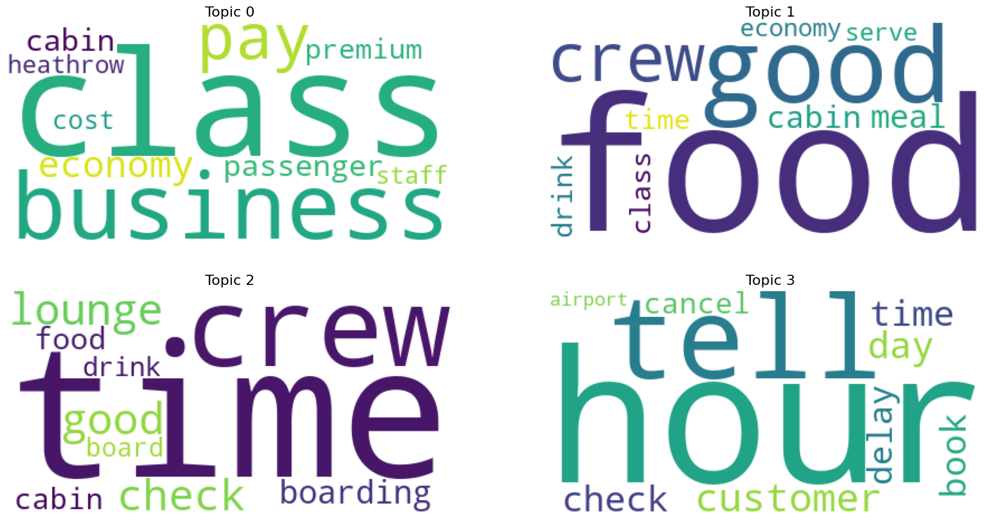

In [30]:
# defining topics
lda_model = LdaMulticore(
    corpus=corpus,
    id2word=dictionary,
    iterations=100,
    num_topics=4,
    workers=4,
    passes=100,
    random_state=STATE,
)
df["topic"] = [
    max(lda_model.get_document_topics(corpus)[i], key=lambda x: x[1])[0]
    for i in range(len(df))
]

# wordclouds for each topic
topics = lda_model.show_topics(formatted=False)
fig, axes = plt.subplots(2, 2, figsize=(20, 10), sharex=True, sharey=True)
for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics[i][1])
    wordcloud.generate_from_frequencies(topic_words, max_font_size=300)
    plt.gca().imshow(wordcloud)
    plt.gca().set_title("Topic " + str(i), fontdict=dict(size=16))
    plt.gca().axis("off")

# visualize topics
show_uniques("topic")
lda_display = pyLDAvis.gensim_models.prepare(lda_model, corpus, dictionary)
pyLDAvis.display(lda_display)

In [31]:
lda_model.print_topics()

[(0,
  '0.028*"class" + 0.025*"business" + 0.019*"pay" + 0.017*"economy" + 0.011*"cabin" + 0.011*"passenger" + 0.009*"premium" + 0.008*"cost" + 0.008*"heathrow" + 0.008*"staff"'),
 (1,
  '0.018*"food" + 0.016*"good" + 0.015*"crew" + 0.013*"meal" + 0.012*"cabin" + 0.009*"time" + 0.009*"class" + 0.009*"drink" + 0.008*"economy" + 0.008*"serve"'),
 (2,
  '0.020*"time" + 0.019*"crew" + 0.018*"lounge" + 0.018*"good" + 0.017*"check" + 0.016*"boarding" + 0.014*"food" + 0.013*"cabin" + 0.011*"drink" + 0.010*"board"'),
 (3,
  '0.017*"hour" + 0.015*"tell" + 0.014*"customer" + 0.012*"day" + 0.012*"check" + 0.012*"time" + 0.011*"book" + 0.010*"delay" + 0.010*"cancel" + 0.009*"airport"')]

Based on the topic modeling analysis, we can draw the following conclusions:

`Topic 0` is related to different classes of travel, such as business and economy, and includes aspects like payment, cabin, passengers, and premium services. It suggests that customers are discussing their experiences and preferences regarding different travel classes.

`Topic 1` focuses on food-related aspects, with mentions of good food, crew service, meals, and drinks. It indicates that customers are discussing their satisfaction or dissatisfaction with the food offerings during their flights.

`Topic 2` revolves around the overall travel experience, including aspects like time management, lounge facilities, check-in procedures, boarding processes, food offerings, and cabin services. Customers seem to be sharing their opinions about these aspects of their journey.

`Topic 3` highlights issues related to time, customer communication, booking, cancellations, delays, and airport experiences. Customers express their concerns about these matters and discuss their experiences and challenges.

Based on the dominant topic distribution, we can see that `topic 1` has the highest representation with 37.2%, followed by `topic 3` (25.3%), `topic 2` (21.2%), and `topic 0` with 373 reviews (16.3%). This distribution suggests that topics related to food and overall travel experience are more frequently discussed by customers.

These topics and their distribution provide valuable insights into different aspects of the airline experience as expressed in the review texts. Analyzing these topics can help the airline identify areas of improvement, such as enhancing food quality and variety, improving the travel experience, addressing time-related issues, and optimizing customer communication and services.

### <a id='toc1_5_2_'></a>[3.2 Correlation Analysis](#toc0_)
Performing a correlation analysis can offer valuable insights into the associations between variables in a dataset. In this analysis, we will utilize the Phik correlation method because it offers advantages in handling categorical variables, capturing non-linear relationships, and providing a comprehensive correlation matrix, making it a suitable choice for our correlation analysis.

interval columns not set, guessing: ['flight_year', 'flight_month', 'seat_comfort', 'cabin_staff_service', 'food_&_beverages', 'inflight_entertainment', 'ground_service', 'wifi_&_connectivity', 'value_for_money', 'rating', 'topic']


/Users/asyl/Desktop/DS/venv2/lib/python3.10/site-packages/phik/bivariate.py:85: DeprecationWarning: Please use `mvnun` from the `scipy.stats` namespace, the `scipy.stats.mvn` namespace is deprecated.
  return mvn.mvnun(lower, upper, mu, S)[0]
/Users/asyl/Desktop/DS/venv2/lib/python3.10/site-packages/phik/bivariate.py:85: DeprecationWarning: Please use `mvnun` from the `scipy.stats` namespace, the `scipy.stats.mvn` namespace is deprecated.
  return mvn.mvnun(lower, upper, mu, S)[0]
/Users/asyl/Desktop/DS/venv2/lib/python3.10/site-packages/phik/bivariate.py:85: DeprecationWarning: Please use `mvnun` from the `scipy.stats` namespace, the `scipy.stats.mvn` namespace is deprecated.
  return mvn.mvnun(lower, upper, mu, S)[0]
/Users/asyl/Desktop/DS/venv2/lib/python3.10/site-packages/phik/bivariate.py:85: DeprecationWarning: Please use `mvnun` from the `scipy.stats` namespace, the `scipy.stats.mvn` namespace is deprecated.
  return mvn.mvnun(lower, upper, mu, S)[0]
/Users/asyl/Desktop/DS/venv2

interval columns not set, guessing: ['flight_year', 'flight_month', 'seat_comfort', 'cabin_staff_service', 'food_&_beverages', 'inflight_entertainment', 'ground_service', 'wifi_&_connectivity', 'value_for_money', 'rating', 'topic']


/Users/asyl/Desktop/DS/venv2/lib/python3.10/site-packages/phik/bivariate.py:85: DeprecationWarning: Please use `mvnun` from the `scipy.stats` namespace, the `scipy.stats.mvn` namespace is deprecated.
  return mvn.mvnun(lower, upper, mu, S)[0]
/Users/asyl/Desktop/DS/venv2/lib/python3.10/site-packages/phik/bivariate.py:85: DeprecationWarning: Please use `mvnun` from the `scipy.stats` namespace, the `scipy.stats.mvn` namespace is deprecated.
  return mvn.mvnun(lower, upper, mu, S)[0]
/Users/asyl/Desktop/DS/venv2/lib/python3.10/site-packages/phik/bivariate.py:85: DeprecationWarning: Please use `mvnun` from the `scipy.stats` namespace, the `scipy.stats.mvn` namespace is deprecated.
  return mvn.mvnun(lower, upper, mu, S)[0]
/Users/asyl/Desktop/DS/venv2/lib/python3.10/site-packages/phik/bivariate.py:85: DeprecationWarning: Please use `mvnun` from the `scipy.stats` namespace, the `scipy.stats.mvn` namespace is deprecated.
  return mvn.mvnun(lower, upper, mu, S)[0]
/Users/asyl/Desktop/DS/venv2

interval columns not set, guessing: ['flight_year', 'flight_month', 'seat_comfort', 'cabin_staff_service', 'food_&_beverages', 'inflight_entertainment', 'ground_service', 'wifi_&_connectivity', 'value_for_money', 'rating', 'topic']


py.stats.mvn` namespace is deprecated.
  return mvn.mvnun(lower, upper, mu, S)[0]
/Users/asyl/Desktop/DS/venv2/lib/python3.10/site-packages/phik/bivariate.py:85: DeprecationWarning: Please use `mvnun` from the `scipy.stats` namespace, the `scipy.stats.mvn` namespace is deprecated.
  return mvn.mvnun(lower, upper, mu, S)[0]
/Users/asyl/Desktop/DS/venv2/lib/python3.10/site-packages/phik/bivariate.py:85: DeprecationWarning: Please use `mvnun` from the `scipy.stats` namespace, the `scipy.stats.mvn` namespace is deprecated.
  return mvn.mvnun(lower, upper, mu, S)[0]
/Users/asyl/Desktop/DS/venv2/lib/python3.10/site-packages/phik/bivariate.py:85: DeprecationWarning: Please use `mvnun` from the `scipy.stats` namespace, the `scipy.stats.mvn` namespace is deprecated.
  return mvn.mvnun(lower, upper, mu, S)[0]
/Users/asyl/Desktop/DS/venv2/lib/python3.10/site-packages/phik/bivariate.py:85: DeprecationWarning: Please use `mvnun` from the `scipy.stats` namespace, the `scipy.stats.mvn` namespace is d

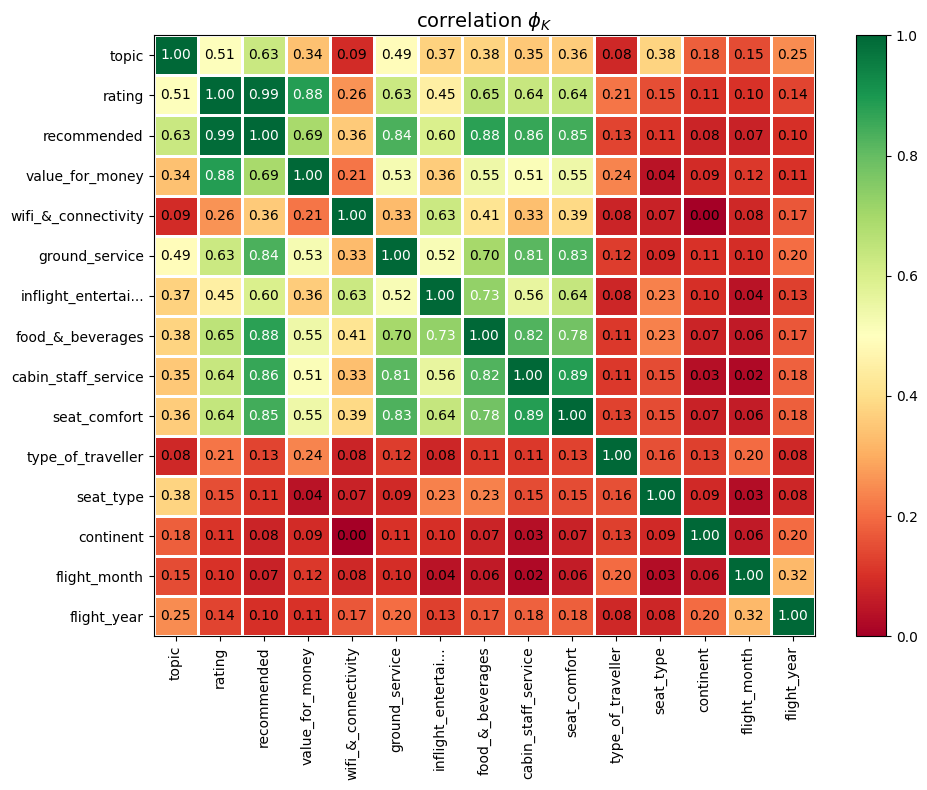

In [32]:
# checking for correlations
df_corr = df.drop(["flight_date", "review_text", "tokens", "title", "country"], axis=1)
plot_correlation_matrix(
    df_corr.phik_matrix().values,
    x_labels=df_corr.phik_matrix().columns,
    y_labels=df_corr.phik_matrix().index,
    vmin=0,
    vmax=1,
    title=r"correlation $\phi_K$",
    figsize=(10, 8),
)
plt.tight_layout()

The Phik correlation matrix revealed strong correlations between the overall recommendation, rating, and various ratings for different services, except for the `wifi_&_connectivity` category. The ratings for this particular service were mostly missing, or if present - negative. Additionally, columns such as flight year, flight month, continent, seat type, and type of traveler did not show significant correlations with other variables in the dataset.

Furthermore, the extracted topics from the review text exhibited correlations with the overall rating and recommendation. This suggests that each topic carries specific semantic meaning related to the customers' experiences. Additionally, it would be beneficial to examine the distributions of other variables separately for positive and negative reviews.

To proceed, we will divide the dataset into two groups: customers who expressed overall satisfaction and customers who did not. This division will enable us to analyze the characteristics and distributions of these two groups separately, providing insights into the factors contributing to customer satisfaction or dissatisfaction.

In [33]:
# divide dataset into positive and negative reviews
dfs = {
    "all": df_corr,
    "negative": df_corr[df_corr["recommended"] == "no"],
    "positive": df_corr[df_corr["recommended"] == "yes"],
}

In [39]:
# positive to negative ratio
pos_ratio = df.groupby(["flight_year", "recommended"]).size().unstack().assign(ratio=lambda x: x.yes / x.sum(1))
pnr = go.Figure()
pnr.add_trace(go.Scatter(x=pos_ratio.index, y=pos_ratio["ratio"]))
pnr.update_layout(
    title="Positive to Negative Reviews Ratio", xaxis_title="Year", yaxis_title="Ratio"
)
pnr.show()

In [40]:
# show each column separately
for col in df_corr.columns:
    draw_graphs(col)

The ratio of positive to negative reviews has shown fluctuations over the years, with the previous year being particularly unfavorable for the airline in terms of customer reviews. Unfortunately, the trend has continued into 2023, with an even worse start to the year. In general, across various columns and distributions, the airline has received approximately two negative reviews for every positive review.

Notable findings from the analysis include:

1. Business travelers tended to provide predominantly negative reviews, while solo leisure travelers were more likely to express positive sentiments.
2. The cabin crew service and ground service received consistently high ratings, even in cases where the overall review was negative. Conversely, food and beverages were often rated poorly.
3. Topic 3, which encompasses issues related to time, customer communication, booking, cancellations, delays, and airport experiences, consistently received negative reviews. Customers expressed their concerns and shared their experiences and challenges related to these matters. This topic also had the lowest number of positive reviews, indicating the need to address these issues to improve customer satisfaction.
4. Topic 0, which focuses on different travel classes (such as business and economy) and includes aspects like payment, cabin, passengers, and premium services, had a relatively high ratio of negative to positive reviews. 
5. The most prominent topic, topic 1, revolved around food-related aspects, including mentions of crew service, meals, and drinks. Customers expressed their satisfaction or dissatisfaction with the food offerings during their flights. However, negative reviews slightly outweighed positive ones in this topic.
6. Topic 2, which encompasses the overall travel experience, including time management, lounge facilities, check-in procedures, boarding processes, food offerings, and cabin services, received a higher number of positive reviews compared to negative ones. Customers mentioned this topic in their reviews approximately twice as often in a positive context.

These findings highlight the importance of addressing issues related to time management, customer communication, and food offerings to improve customer satisfaction. Additionally, understanding and catering to the preferences and needs of different traveler segments, such as business and leisure travelers, can help enhance the overall customer experience.

## <a id='toc1_6_'></a>[4. Conclusion](#toc0_)

The findings and insights obtained from the data analysis of the British Airways reviews dataset are as follows:

1. The dataset contains a total of 3,553 reviews from the Air Travel review website, focusing specifically on British Airways.

2. To determine the relevancy of reviews, a date threshold of 7 years was established, considering the evolving nature of the airline industry. Reviews older than this threshold may be considered less relevant. Dataset decreased to 2, 293 reviews.

3. The majority of customers express dissatisfaction or negative experiences with the airline, as indicated by the overall recommendation column. The most common rating received by British Airways is 1, accounting for 26.9% of the total reviews. The ratio of positive to negative reviews has fluctuated over the years, with the previous year being particularly unfavorable for the airline. Unfortunately, this negative trend has continued into 2023, with an even worse start to the year. On average, the airline has received approximately two negative reviews for every positive review, indicating a significant disparity.

4. Despite the overall negative sentiment, there are specific areas where the airline has performed well. Both the cabin crew service and ground service consistently receive high ratings, even in cases where the overall review is negative. This implies that customers appreciate the efforts and professionalism of the airline's staff in these areas. On the other hand, food and beverage offerings consistently receive poor ratings, suggesting a need for improvement in this aspect of the customer experience.

5. The distribution of the type of travelers shows that the majority are solo leisure travelers or couples on leisure trips, followed by business travelers. The proportion of families on leisure trips is relatively lower. Digging deeper into the reviews, it becomes evident that different traveler segments have distinct preferences and sentiments. Business travelers, for instance, tend to provide predominantly negative reviews, suggesting that their experiences with the airline may have been unsatisfactory. In contrast, solo leisure travelers express more positive sentiments in their reviews, indicating a relatively better experience for this particular segment.
6. Economy class was the most frequently chosen seat type, indicating that affordability and cost-consciousness are important factors for a significant portion of customers. Business class and premium economy class were also popular choices, suggesting a demand for additional comfort and amenities. First class seats were chosen by a smaller but discerning group of customers seeking the utmost luxury and premium travel experience.
7. Text preprocessing was performed on the review text, including cleaning, lowercase conversion, stopword removal, and lemmatization. Topic modeling analysis identified four main topics discussed in the reviews:
   - Topic 0, which focuses on different travel classes (such as business and economy) and includes aspects like payment, cabin, passengers, and premium services, shows a relatively high ratio of negative to positive reviews. This suggests that customers have been dissatisfied with aspects related to travel classes and associated services.
   - The most prominent topic, Topic 1, revolves around food-related aspects, including crew service, meals, and drinks. Customers express their satisfaction or dissatisfaction with the food offerings during their flights. However, negative reviews slightly outweigh positive ones in this topic, indicating room for improvement in the airline's food services.
   - Topic 2, encompassing the overall travel experience, including time management, lounge facilities, check-in procedures, boarding processes, food offerings, and cabin services, receives a higher number of positive reviews compared to negative ones. Customers mention this topic more frequently in a positive context, suggesting that the airline is generally meeting or exceeding expectations in these areas.
   - Topic 3, encompassing issues related to time management, customer communication, booking, cancellations, delays, and airport experiences, consistently receives negative reviews. This indicates that customers are concerned about these matters and have faced challenges in these areas. Furthermore, Topic 3 has the lowest number of positive reviews, highlighting the urgent need to address these issues to enhance customer satisfaction.

In summary, these insights point to several areas that require attention to improve customer satisfaction. Addressing issues related to time management, customer communication, and food offerings is crucial. Additionally, understanding and catering to the preferences and needs of different traveler segments, such as business and leisure travelers, can help enhance the overall customer experience. By focusing on these areas, the airline can work towards improving its reputation and customer satisfaction levels.